1. Start the Weaviate instance: `docker compose up`
2. Run code below

In [8]:
import pickle, weaviate, json, os, IPython

In [9]:
#Connect to the locally launched instance of Weaviate

client = weaviate.Client("http://localhost:8080")

print(f"Client created? {client.is_ready()}")

Client created? True


/home/codespace/.python/current/lib/python3.10/site-packages/weaviate/warnings.py:158: DeprecationWarning: Dep016: You are using the Weaviate v3 client, which is deprecated.
            Consider upgrading to the new and improved v4 client instead!
            See here for usage: https://weaviate.io/developers/weaviate/client-libraries/python
            
  warnings.warn(


In [10]:
#Make sure that we don't have a class already created

current_schemas = client.schema.get()['classes']

for schema in current_schemas:
    if schema['class']=='ClipExample':
        client.schema.delete_class('ClipExample')

In [11]:
#Create a class object that uses a multi2vec module
#A multi2vec module understands multiple types of data - there are 

class_obj = {
    "class": "ClipExample",
    "moduleConfig": {
        "multi2vec-clip": {"imageFields": ["image"]}
    },
    
    'vectorizer':"multi2vec-clip",
    
    "properties" : [{"name": "text", "dataType":["string"]},
                   {
                       "name": "image", 'dataType':["blob"]
                   }]
}

client.schema.create_class(class_obj)
print("Schema class created")

#=====================================================
import pickle, weaviate, json, os, IPython
#Add images to our created class

for img in os.listdir("/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/Images/"):
    print(f"Images/{img}")
    
    encoded_image = weaviate.util.image_encoder_b64(f"/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/Images/{img}")
    
    data_properties = {
        "image":encoded_image,
        "text": img
    }
    
    client.data_object.create(data_properties, "ClipExample")
    
print("All images added!")

Schema class created
Images/Conservatory_LIL_9680.jpg
Images/Ornate furniture_LIL_134195.jpg
Images/Spiral staircase_LIL_134156.jpg
Images/Cat_LIL_134138.jpg


Images/Deer_LIL_134180.jpg
Images/Walking dog on beach_LIL_134163.jpg
Images/Stack of books_LIL_134182.jpg
Images/Microphone_LIL_134215.jpg
Images/Reading outside_LIL_134129.jpg
Images/Golden Gate Bridge from Presidio_LIL_9682.jpg
Images/Single cyclist with land background_LIL_9376.dng
Images/Llama_LIL_134178.jpg
Images/Joshua Tree and California coast_LIL_9670.jpg
Images/Dog in motion_LIL_134175.jpg
Images/Big Sur_ California_LIL_9678.jpg
Images/Wearing a white dress _LIL_134222.jpg
Images/Blue sky between skyscrapers_LIL_134160.jpg
Images/Feet under a skirt_LIL_134201.jpg
Images/Forest_LIL_134133.jpg
Images/Point Reyes_ California_LIL_9672.jpg
Images/Kitchen scene_LIL_134191.jpg
Images/Pies and dishes_LIL_134217.jpg
Images/Cats on a chair_LIL_134151.jpg
Images/Cityscape_LIL_134155.jpg
Images/Table setting outdoor_LIL_134165.jpg
Images/Bird feeder_LIL_134172.jpg
Images/Onlookers contemplating_LIL_134225.jpg
Images/Joshua Tree and California coast_LIL_9662.jpg
Images/Speaker_LIL_134226

In [1]:
! pwd

/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03


In [7]:
# import pickle, weaviate, json, os, IPython                 SCOPE!!!
# #Add images to our created class

# for img in os.listdir("/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/Images/"):
#     print(f"Images/{img}")
    
#     encoded_image = weaviate.util.image_encoder_b64(f"/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/Images/{img}")
    
#     data_properties = {
#         "image":encoded_image,
#         "text": img
#     }
    
#     client.data_object.create(data_properties, "ClipExample")
    
# print("All images added!")

Images/Conservatory_LIL_9680.jpg


NameError: name 'client' is not defined

### Text to image search

In [12]:
#Lets search for images of "open sea beach"

res = (client.query
       .get('ClipExample',['text',"_additional {distance} "])
       .with_near_text({"concepts":"open sea beach"})
       .with_limit(5)
       .do()
)

print(json.dumps(res,indent=2))

{
  "data": {
    "Get": {
      "ClipExample": [
        {
          "_additional": {
            "distance": 0.7255124
          },
          "text": "Point Reyes_ California_LIL_9672.jpg"
        },
        {
          "_additional": {
            "distance": 0.73806083
          },
          "text": "Big Sur_ California_LIL_9678.jpg"
        },
        {
          "_additional": {
            "distance": 0.7766465
          },
          "text": "Walking dog on beach_LIL_134163.jpg"
        },
        {
          "_additional": {
            "distance": 0.7825916
          },
          "text": "On a grassy hill_LIL_134221.jpg"
        },
        {
          "_additional": {
            "distance": 0.79671466
          },
          "text": "Golden Gate Bridge from Presidio_LIL_9682.jpg"
        }
      ]
    }
  }
}


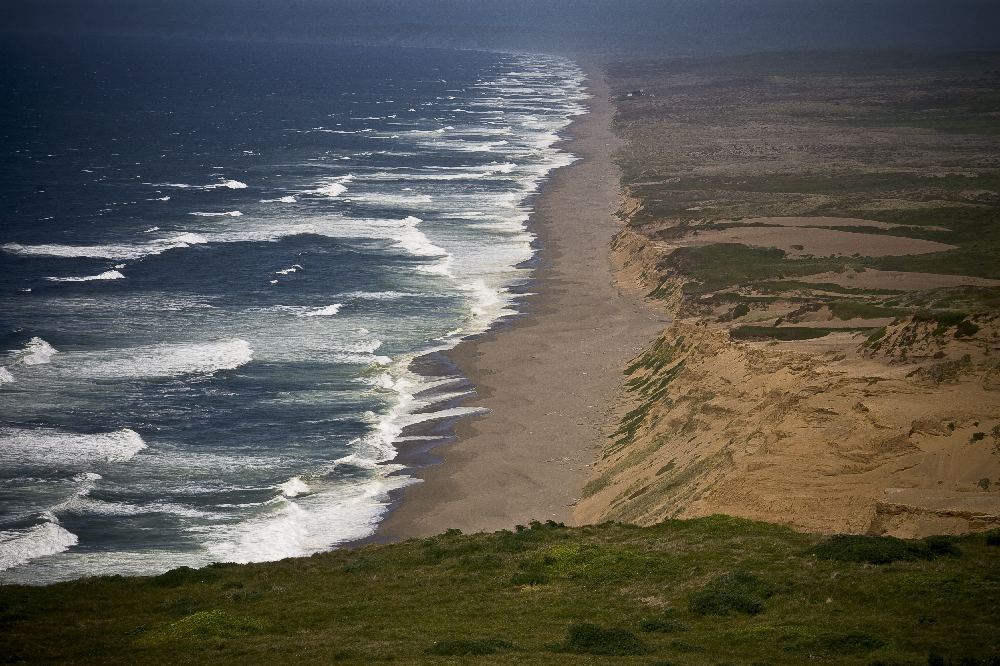

In [13]:
#Lets visualize the images that came back
IPython.display.Image(filename='Images/Point Reyes_ California_LIL_9672.jpg',width=300) 

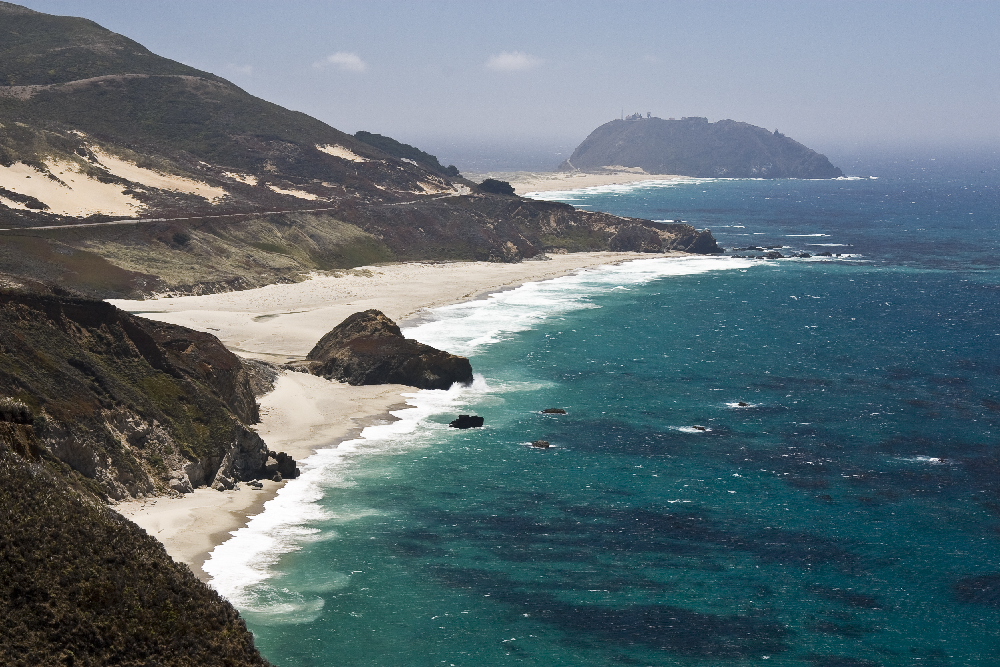

In [14]:
#Lets visualize the images that came back
IPython.display.Image(filename='Images/Big Sur_ California_LIL_9678.jpg',width=300) 

In [15]:
#Search for another concept!

res = (client.query
       .get('ClipExample',['text',"_additional {distance} "])
       .with_near_text({"concepts":"greenery and trees"})
       .with_limit(5)
       .do()
)

print(json.dumps(res,indent=2))

{
  "data": {
    "Get": {
      "ClipExample": [
        {
          "_additional": {
            "distance": 0.74983835
          },
          "text": "Forest_LIL_134133.jpg"
        },
        {
          "_additional": {
            "distance": 0.7561507
          },
          "text": "Spiral staircase_LIL_134156.jpg"
        },
        {
          "_additional": {
            "distance": 0.768982
          },
          "text": "Golden Gate Bridge from Presidio_LIL_9682.jpg"
        },
        {
          "_additional": {
            "distance": 0.77236956
          },
          "text": "Conservatory_LIL_9680.jpg"
        },
        {
          "_additional": {
            "distance": 0.7783147
          },
          "text": "Feet under a skirt_LIL_134201.jpg"
        }
      ]
    }
  }
}


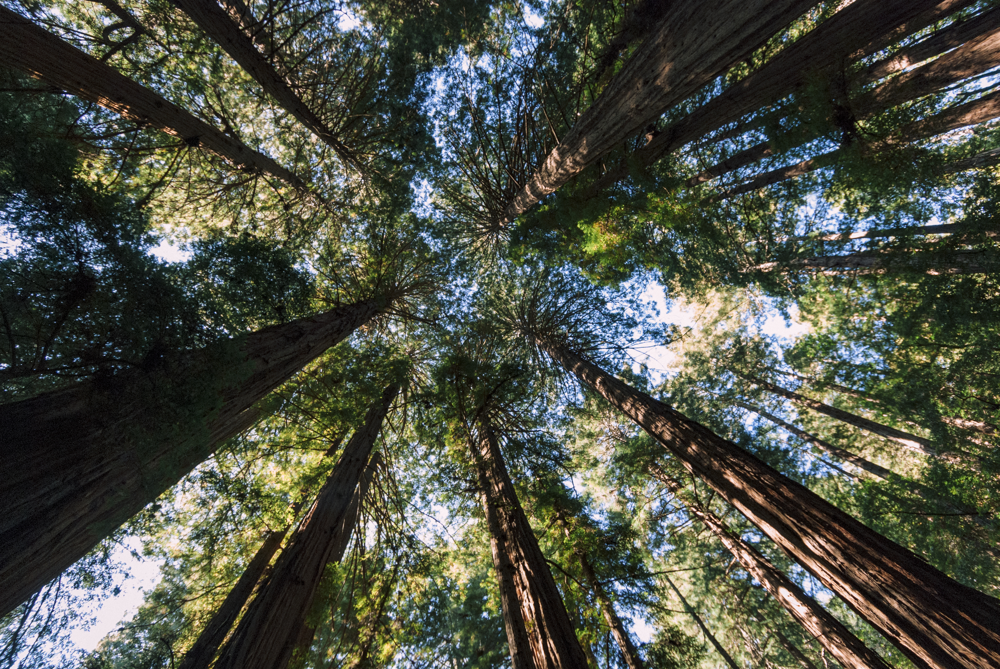

In [16]:
#Lets visualize the images that came back
IPython.display.Image(filename='Images/Forest_LIL_134133.jpg',width=300) 

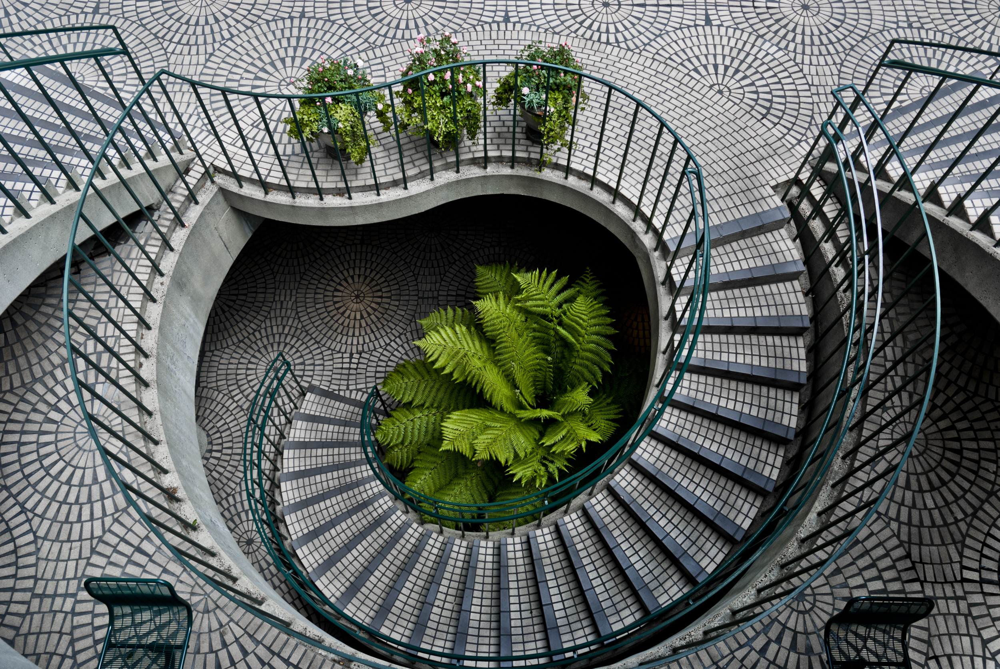

In [17]:
#Lets visualize the images that came back
IPython.display.Image(filename='Images/Spiral staircase_LIL_134156.jpg',width=300) 

### Image to image search

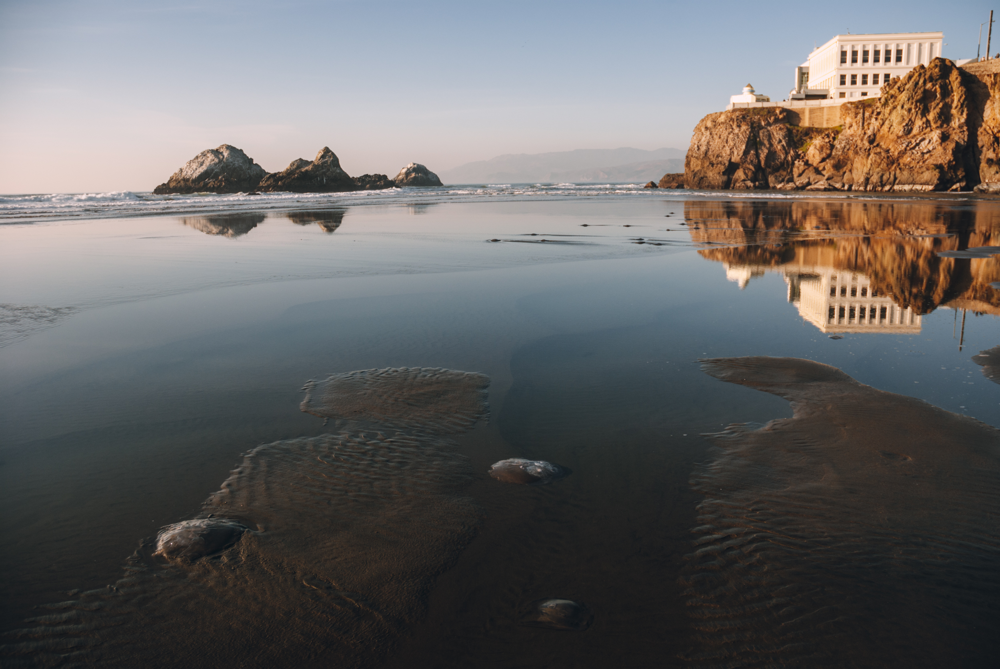

In [14]:
#Lets look at an input image query

IPython.display.Image(filename='TestImages/Beach with a building_LIL_134146.jpg',width=300) 

In [18]:
#Lets search for images using a query image

#TestImages/Beach with a building_LIL_134146.jpg

res = (client.query
       .get('ClipExample',['text',"_additional {distance} "])
       .with_near_image({"image":"TestImages/Beach with a building_LIL_134146.jpg"})
       .with_limit(5)
       .do()
)

print(json.dumps(res,indent=2))

{
  "data": {
    "Get": {
      "ClipExample": [
        {
          "_additional": {
            "distance": 0.22762054
          },
          "text": "Big Sur_ California_LIL_9678.jpg"
        },
        {
          "_additional": {
            "distance": 0.2604211
          },
          "text": "Golden Gate Bridge from Presidio_LIL_9682.jpg"
        },
        {
          "_additional": {
            "distance": 0.27988183
          },
          "text": "Point Reyes_ California_LIL_9672.jpg"
        },
        {
          "_additional": {
            "distance": 0.28169328
          },
          "text": "On a grassy hill_LIL_134221.jpg"
        },
        {
          "_additional": {
            "distance": 0.2896189
          },
          "text": "Forest_LIL_134133.jpg"
        }
      ]
    }
  }
}


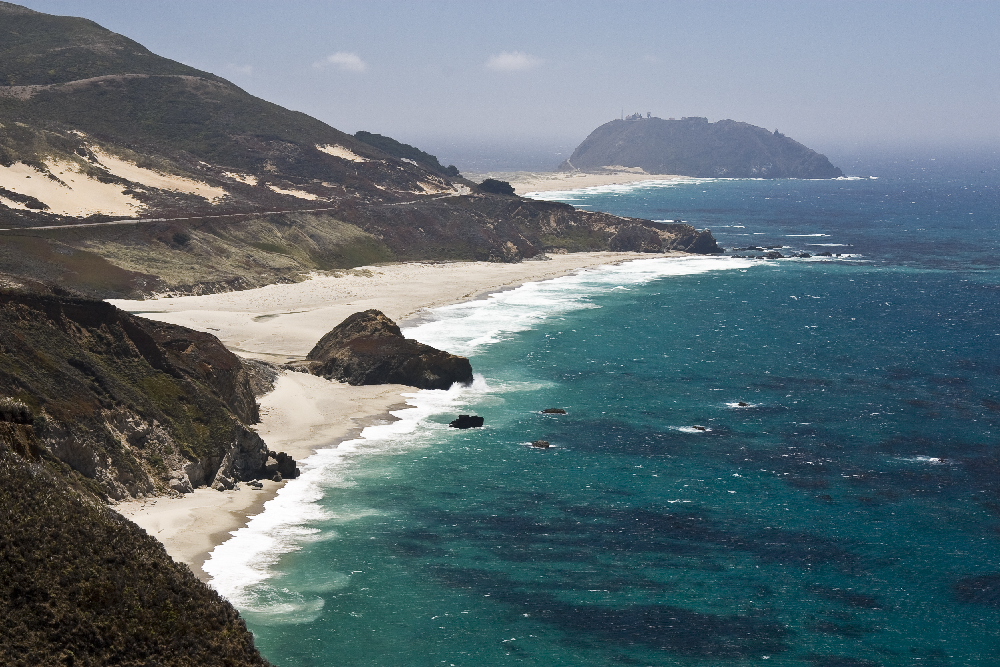

In [19]:
#Lets visualize the images that came back
IPython.display.Image(filename='Images/Big Sur_ California_LIL_9678.jpg',width=300) 

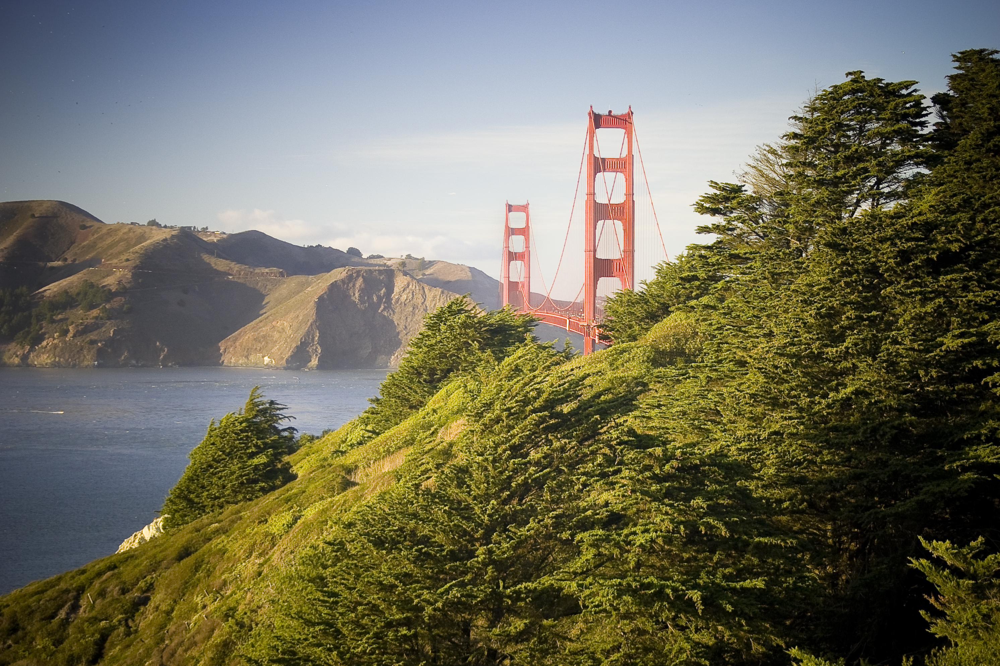

In [20]:
#Lets visualize the images that came back
IPython.display.Image(filename='Images/Golden Gate Bridge from Presidio_LIL_9682.jpg',width=300) 

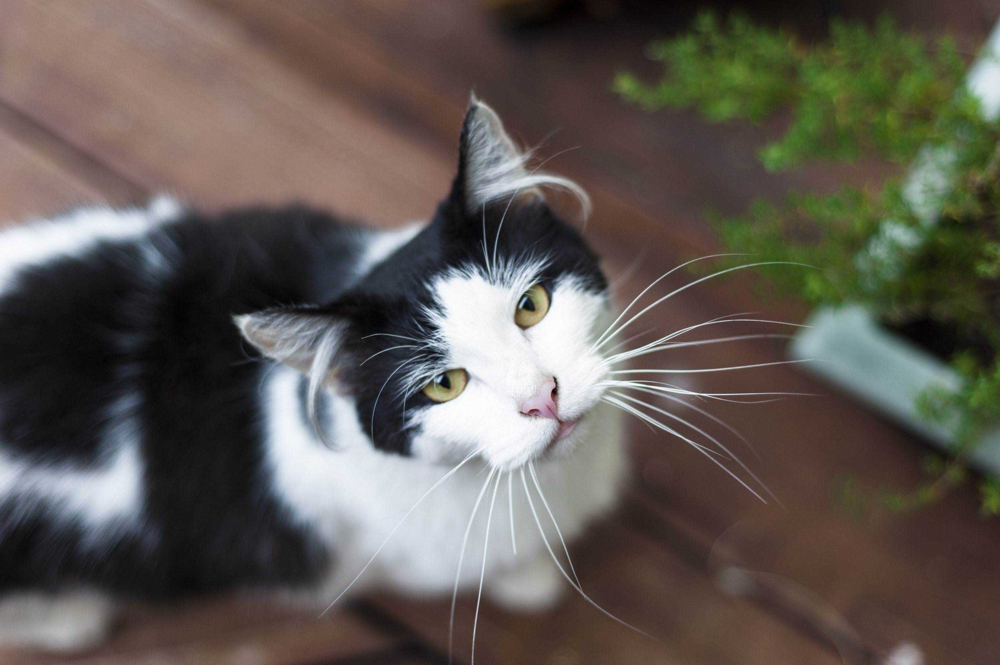

In [21]:
#Lets look at another input image query

IPython.display.Image(filename='TestImages/Cat outside_LIL_134200.jpg',width=300)  

In [22]:
res = (client.query
       .get('ClipExample',['text',"_additional {distance} "])
       .with_near_image({"image":'TestImages/Cat outside_LIL_134200.jpg'})
       .with_limit(5)
       .do()
)

print(json.dumps(res,indent=2))

{
  "data": {
    "Get": {
      "ClipExample": [
        {
          "_additional": {
            "distance": 0.121379495
          },
          "text": "Cat_LIL_134138.jpg"
        },
        {
          "_additional": {
            "distance": 0.22747862
          },
          "text": "Cats on a chair_LIL_134151.jpg"
        },
        {
          "_additional": {
            "distance": 0.2813356
          },
          "text": "Bird feeder_LIL_134172.jpg"
        },
        {
          "_additional": {
            "distance": 0.3113258
          },
          "text": "Dog in motion_LIL_134175.jpg"
        },
        {
          "_additional": {
            "distance": 0.31550348
          },
          "text": "Feet under a skirt_LIL_134201.jpg"
        }
      ]
    }
  }
}


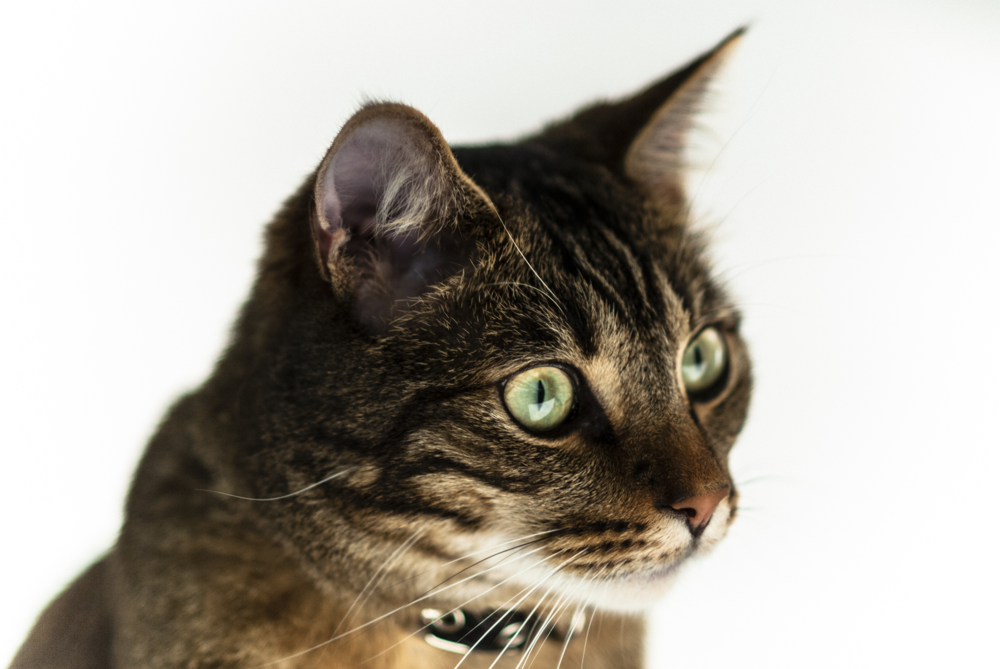

In [23]:
#Lets visualize the images that came back
IPython.display.Image(filename='Images/Cat_LIL_134138.jpg',width=300) 